# ПРОЕКТ "Предсказание цен на недвижимость"
 

### 1. Выбор датасета

*Real Estate Price Prediction*


Датасет был взят из источника:

https://www.kaggle.com/competitions/realestatepriceprediction/


**Описание полей:**

Id - идентификационный номер квартиры

DistrictId - идентификационный номер района

Rooms - количество комнат

Square - площадь

LifeSquare - жилая площадь

KitchenSquare - площадь кухни

Floor - этаж

HouseFloor - количество этажей в доме

HouseYear - год постройки дома

Ecology_1, Ecology_2, Ecology_3 - экологические показатели местности

Social_1, Social_2, Social_3 - социальные показатели местности

Healthcare_1, Helthcare_2 - показатели местности, связанные с охраной здоровья

Shops_1, Shops_2 - показатели, связанные с наличием магазинов, торговых центров


*Целевая переменная:*

Price - цена квартиры

In [62]:
# Загрузка необходимых библиотек и модулей


import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import datetime # для работы со времнем
import dill

from sklearn.pipeline import Pipeline, make_pipeline
from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.pipeline import FeatureUnion

from sklearn.preprocessing import StandardScaler

from sklearn import ensemble
from matplotlib import style
from sklearn.ensemble import RandomForestRegressor
from sklearn.linear_model import LinearRegression
from lightgbm import LGBMRegressor

import ydata_profiling

from sklearn.metrics import r2_score
from sklearn.model_selection import train_test_split, KFold, GridSearchCV, cross_val_score

style.use('fivethirtyeight')
%matplotlib inline

In [6]:
# Чтение данных

# https://www.kaggle.com/competitions/realestatepriceprediction/data?select=train.csv
TRAIN_DATASET_PATH = 'train.csv'

# https://www.kaggle.com/competitions/realestatepriceprediction/data?select=test.csv
TEST_DATASET_PATH = 'test.csv'

X_final = pd.read_csv(TEST_DATASET_PATH)
X = pd.read_csv(TRAIN_DATASET_PATH)

X.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10000 entries, 0 to 9999
Data columns (total 20 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Id             10000 non-null  int64  
 1   DistrictId     10000 non-null  int64  
 2   Rooms          10000 non-null  float64
 3   Square         10000 non-null  float64
 4   LifeSquare     7887 non-null   float64
 5   KitchenSquare  10000 non-null  float64
 6   Floor          10000 non-null  int64  
 7   HouseFloor     10000 non-null  float64
 8   HouseYear      10000 non-null  int64  
 9   Ecology_1      10000 non-null  float64
 10  Ecology_2      10000 non-null  object 
 11  Ecology_3      10000 non-null  object 
 12  Social_1       10000 non-null  int64  
 13  Social_2       10000 non-null  int64  
 14  Social_3       10000 non-null  int64  
 15  Healthcare_1   5202 non-null   float64
 16  Helthcare_2    10000 non-null  int64  
 17  Shops_1        10000 non-null  int64  
 18  Shops_2

In [4]:
X_final.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5000 entries, 0 to 4999
Data columns (total 19 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Id             5000 non-null   int64  
 1   DistrictId     5000 non-null   int64  
 2   Rooms          5000 non-null   float64
 3   Square         5000 non-null   float64
 4   LifeSquare     3959 non-null   float64
 5   KitchenSquare  5000 non-null   float64
 6   Floor          5000 non-null   int64  
 7   HouseFloor     5000 non-null   float64
 8   HouseYear      5000 non-null   int64  
 9   Ecology_1      5000 non-null   float64
 10  Ecology_2      5000 non-null   object 
 11  Ecology_3      5000 non-null   object 
 12  Social_1       5000 non-null   int64  
 13  Social_2       5000 non-null   int64  
 14  Social_3       5000 non-null   int64  
 15  Healthcare_1   2623 non-null   float64
 16  Helthcare_2    5000 non-null   int64  
 17  Shops_1        5000 non-null   int64  
 18  Shops_2 

In [5]:
# Подробно посмотрим на свойства датафрейма
ydata_profiling.ProfileReport(X)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [8]:
X.columns

Index(['Id', 'DistrictId', 'Rooms', 'Square', 'LifeSquare', 'KitchenSquare',
       'Floor', 'HouseFloor', 'HouseYear', 'Ecology_1', 'Ecology_2',
       'Ecology_3', 'Social_1', 'Social_2', 'Social_3', 'Healthcare_1',
       'Helthcare_2', 'Shops_1', 'Shops_2', 'Price'],
      dtype='object')

In [13]:
df = df.sort_values('Price')
df

,Id,DistrictId,Rooms,Square,LifeSquare,KitchenSquare,Floor,HouseFloor,HouseYear,Ecology_1,Ecology_2,Ecology_3,Social_1,Social_2,Social_3,Healthcare_1,Helthcare_2,Shops_1,Shops_2,Price
9732,13237,144,2.0,51.726692,30.547287,8.0,2,14.0,1988,0.306977,B,B,27,5148,14,1575.0,5,7,B,59174.778028
3605,7243,9,2.0,58.089253,52.460857,8.0,5,22.0,1981,0.136244,B,B,11,2370,0,NaN,0,1,B,59877.592523
7850,8800,23,1.0,29.706031,NaN,0.0,5,12.0,1977,0.034656,B,B,0,168,0,NaN,0,0,B,60502.583500
9961,1579,23,1.0,27.331108,NaN,1.0,10,12.0,1977,0.034656,B,B,0,168,0,NaN,0,0,B,60825.032060
6856,2648,23,1.0,34.670830,NaN,0.0,4,0.0,1977,0.005767,B,B,1,388,0,NaN,0,0,B,60828.260686
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3228,15192,26,3.0,117.714551,57.440648,15.0,17,30.0,2012,0.000000,B,B,36,6714,2,2672.0,0,2,B,624680.099059
4764,11013,43,2.0,58.757047,34.605286,8.0,12,17.0,2004,0.000078,B,B,22,6398,141,1046.0,3,23,B,625678.644994
1537,3206,54,3.0,125.117838,NaN,1.0,4,1.0,1977,0.006076,B,B,30,5285,0,645.0,6,6,B,625820.041178
8143,15251,17,3.0,125.017368,NaN,0.0,24,0.0,1977,0.093443,B,B,23,4635,5,3300.0,2,4,B,627525.072788


In [17]:
# Смотрим на выбросы Square
X.sort_values(by = 'Square', ascending = False)

,Id,DistrictId,Rooms,Square,LifeSquare,KitchenSquare,Floor,HouseFloor,HouseYear,Ecology_1,Ecology_2,Ecology_3,Social_1,Social_2,Social_3,Healthcare_1,Helthcare_2,Shops_1,Shops_2,Price
6977,11602,30,2.0,641.065193,638.163193,10.0,20,19.0,2019,0.000078,B,B,22,6398,141,1046.0,3,23,B,133529.681562
4262,28,9,2.0,604.705972,NaN,1.0,17,18.0,1977,0.161532,B,B,25,5648,1,30.0,2,4,B,187717.242538
4690,2307,102,1.0,409.425181,410.639749,10.0,4,4.0,2016,0.238617,B,B,26,3889,6,705.0,3,6,B,90470.430830
1982,5548,86,5.0,275.645284,233.949309,26.0,12,37.0,2011,0.161976,B,A,31,7010,5,4508.0,3,7,B,455264.882666
1981,7917,27,0.0,212.932361,211.231125,0.0,2,3.0,2008,0.211401,B,B,9,1892,0,NaN,0,1,B,302211.260887
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9294,6782,45,1.0,2.954309,5.257278,1.0,3,1.0,1977,0.195781,B,B,23,5212,6,NaN,3,2,B,438005.182323
1608,10202,6,1.0,2.596351,4.604943,1.0,3,25.0,2014,0.243205,B,B,5,1564,0,540.0,0,0,B,137597.601458
4853,3224,27,0.0,2.377248,0.873147,0.0,1,0.0,1977,0.017647,B,B,2,469,0,NaN,0,0,B,126596.941798
8283,15744,34,1.0,1.988943,2.642219,1.0,21,4.0,1977,0.069753,B,B,53,13670,4,NaN,1,11,B,458378.777006


In [18]:
# Удаляем выбросы Square
X = X.drop(X[X['Id'] == 11602].index)
X = X.drop(X[X['Id'] == 28].index)
X = X.drop(X[X['Id'] == 2307].index)

In [20]:
# Смотрим на выбросы Rooms

X.sort_values(by = 'Rooms', ascending = False)

,Id,DistrictId,Rooms,Square,LifeSquare,KitchenSquare,Floor,HouseFloor,HouseYear,Ecology_1,Ecology_2,Ecology_3,Social_1,Social_2,Social_3,Healthcare_1,Helthcare_2,Shops_1,Shops_2,Price
1454,8491,1,19.0,42.006046,21.779288,7.0,17,17.0,2014,0.007122,B,B,1,264,0,NaN,0,1,B,78364.616704
8849,14865,9,10.0,60.871266,38.420681,10.0,3,2.0,1994,0.161532,B,B,25,5648,1,30.0,2,4,B,172329.270863
377,5927,57,10.0,59.056975,36.223072,10.0,22,22.0,2002,0.090799,B,B,74,19083,2,NaN,5,15,B,317265.323792
2170,14003,99,6.0,59.414334,38.702244,6.0,7,9.0,1969,0.033494,B,B,66,10573,1,1322.0,3,8,B,229661.964416
8511,4249,23,5.0,198.930182,123.139863,10.0,1,2.0,2011,0.014073,B,B,2,475,0,NaN,0,0,B,345665.209100
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6149,3159,88,0.0,38.697117,19.345131,9.0,9,16.0,1982,0.127376,B,B,43,8429,3,NaN,3,9,B,158998.110646
2269,7317,27,0.0,41.790881,NaN,0.0,13,0.0,1977,0.211401,B,B,9,1892,0,NaN,0,1,B,98129.976788
4366,456,6,0.0,81.491446,NaN,0.0,4,0.0,1977,0.243205,B,B,5,1564,0,540.0,0,0,B,212864.799112
3911,770,28,0.0,49.483501,NaN,0.0,16,0.0,2015,0.118537,B,B,30,6207,1,1183.0,1,0,B,217009.338463


In [21]:
# Удаляем выбросы Rooms

X = X.drop(X[X['Id'] == 8491].index)
X = X.drop(X[X['Id'] == 5927].index)
X = X.drop(X[X['Id'] == 14865].index)

In [25]:
# Смотрим на выбросы LifeSquare

X.sort_values(by = 'LifeSquare', ascending = False)[:10]


,Id,DistrictId,Rooms,Square,LifeSquare,KitchenSquare,Floor,HouseFloor,HouseYear,Ecology_1,Ecology_2,Ecology_3,Social_1,Social_2,Social_3,Healthcare_1,Helthcare_2,Shops_1,Shops_2,Price
4328,16550,27,3.0,81.694417,7480.592129,1.0,9,17.0,2016,0.017647,B,B,2,469,0,NaN,0,0,B,217357.492366
8437,15886,85,3.0,78.059331,461.463614,10.0,12,16.0,1998,0.037178,B,B,52,11217,1,2300.0,1,7,B,394253.299978
590,14990,23,2.0,48.449873,263.542020,5.0,6,5.0,1972,0.075779,B,B,6,1437,3,NaN,0,2,B,141780.231857
1982,5548,86,5.0,275.645284,233.949309,26.0,12,37.0,2011,0.161976,B,A,31,7010,5,4508.0,3,7,B,455264.882666
1981,7917,27,0.0,212.932361,211.231125,0.0,2,3.0,2008,0.211401,B,B,9,1892,0,NaN,0,1,B,302211.260887
9910,16568,27,4.0,200.334539,201.627361,25.0,1,2.0,2013,0.041116,B,B,53,14892,4,NaN,1,4,B,528560.506016
1641,11055,151,1.0,174.649522,174.837082,15.0,10,12.0,1958,0.236108,B,B,16,3893,27,NaN,3,10,B,232766.187698
3651,5300,30,3.0,169.509941,170.713651,1.0,2,2.0,2018,0.000078,B,B,22,6398,141,1046.0,3,23,B,200800.673767
8913,2603,30,3.0,162.587886,164.526757,0.0,2,3.0,1977,0.000078,B,B,22,6398,141,1046.0,3,23,B,207407.352593
6332,8961,27,1.0,33.398983,164.153360,6.0,3,5.0,1965,0.211401,B,B,9,1892,0,NaN,0,1,B,104891.073757


In [26]:
# Удаляем выбросы LifeSquare (будем удалять все выше 200 кв.м.)

X = X.drop(X[X['Id'] == 16550].index)
X = X.drop(X[X['Id'] == 15886].index)
X = X.drop(X[X['Id'] == 14990].index)
X = X.drop(X[X['Id'] == 5548].index)
X = X.drop(X[X['Id'] == 7917].index)
X = X.drop(X[X['Id'] == 16568].index)

In [28]:
X.sort_values(by = 'KitchenSquare', ascending = False)[:10]

,Id,DistrictId,Rooms,Square,LifeSquare,KitchenSquare,Floor,HouseFloor,HouseYear,Ecology_1,Ecology_2,Ecology_3,Social_1,Social_2,Social_3,Healthcare_1,Helthcare_2,Shops_1,Shops_2,Price
1064,14656,62,1.0,47.100719,46.447960,2014.0,4,1.0,2014,0.072158,B,B,2,629,1,NaN,0,0,A,108337.484207
8584,14679,81,1.0,32.276663,19.278394,1970.0,6,1.0,1977,0.006076,B,B,30,5285,0,645.0,6,6,B,105539.556275
9895,2737,27,3.0,123.430072,125.806981,123.0,5,10.0,2015,0.017647,B,B,2,469,0,NaN,0,0,B,234194.837047
4651,12552,58,3.0,116.405693,113.109653,112.0,3,3.0,2016,0.437885,B,B,23,5735,3,1084.0,0,5,B,296165.936689
2969,7441,62,3.0,114.734473,112.589083,112.0,3,3.0,2015,0.072158,B,B,2,629,1,NaN,0,0,A,315245.521059
2916,12390,72,3.0,97.490674,99.323558,96.0,22,25.0,2019,0.210473,B,B,11,2398,2,1994.0,3,0,B,445074.956552
7088,6569,27,1.0,38.220258,18.716856,84.0,4,17.0,2018,0.011654,B,B,4,915,0,NaN,0,0,B,99079.960518
1455,12507,54,2.0,79.810535,79.578961,78.0,10,15.0,2014,0.006076,B,B,30,5285,0,645.0,6,6,B,438708.707579
6240,4966,96,3.0,78.445675,47.146757,75.0,9,12.0,1977,0.041116,B,B,53,14892,4,NaN,1,4,B,290354.484070
5149,13703,42,1.0,38.071692,19.723548,73.0,9,10.0,2006,0.158249,B,B,21,5731,0,NaN,1,0,B,160488.033165


In [29]:
# Создаем класс для преобразования выбросов


class FeatureImputer:
    """Заполнение пропусков и обработка выбросов"""
    
    def __init__(self):
        self.medians=None
        
    def fit(self, X):
        self.medians = X.median()
    
    def transform(self, X):
        
        # Rooms
        X['Rooms_outlier'] = 0
        X.loc[(X['Rooms'] == 0) | (X['Rooms'] >= 6), 'Rooms_outlier'] = 1
        
        X.loc[X['Rooms'] == 0, 'Rooms'] = 1
        X.loc[X['Rooms'] >= 6, 'Rooms'] = self.medians['Rooms'] 
        X.loc[(X['Rooms'] > 5) & (X['Square'] < 50),'Rooms'] = 2
        
        # Square
        X.loc[X['Square'] < 10,'Square']= X.loc[X['Square'] < 10,'Square']*10
        X.loc[X['Square'] < 1,'Square'] = X.loc[X['Square']<1,'Square']*100 
        X.loc[X['Square'] > 250, 'Square'] = self.medians['Square'] 
        
        # KitchenSquare
        X.loc[X['KitchenSquare'] < 3, 'KitchenSquare'] = 3
        X.loc[X['KitchenSquare'] > 40, 'KitchenSquare'] = self.medians['KitchenSquare']
        
        # HouseFloor, Floor
        X['HouseFloor_outlier'] = 0
        X.loc[X['HouseFloor'] == 0, 'HouseFloor_outlier'] = 1
        X.loc[X['Floor'] > X['HouseFloor'], 'HouseFloor_outlier'] = 1
        
        X.loc[X['HouseFloor'] == 0, 'HouseFloor'] = self.medians['HouseFloor']
        X.loc[X['Floor'] > X['HouseFloor'], 'Floor'] = X.loc[X['Floor'] > X['HouseFloor'], 'HouseFloor']
        
        # HouseYear
        current_year = now = datetime.datetime.now().year
        
        X['HouseYear_outlier'] = 0
        X.loc[X['HouseYear'] > current_year, 'HouseYear_outlier'] = 1
        
        X.loc[X['HouseYear'] > current_year, 'HouseYear'] = self.medians['HouseYear']
        
        # Healthcare_1
        if 'Healthcare_1' in X.columns:
            X.drop('Healthcare_1', axis=1, inplace=True)
            
        # LifeSquare
        X['LifeSquare_nan'] = X['LifeSquare'].isna() * 1
        
        X.loc[(X['LifeSquare'] > 200) &\
               (X['Square'] < 100),'LifeSquare']=X.loc[(X['LifeSquare']>200) & (X['Square']<100),'LifeSquare']/10
        
        condition = (X['LifeSquare'].isna()) &\
                      (~X['Square'].isna()) & \
                      (~X['KitchenSquare'].isna())
        
        X.loc[condition, 'LifeSquare'] = X.loc[condition, 'Square'] * 0.65
        
        
        return X

In [30]:
imputer = FeatureImputer()

imputer.fit(X) # расчет медиан

X = imputer.transform(X)
X_final = imputer.transform(X_final)

C:\Users\user\AppData\Local\Temp\ipykernel_6140\3847949427.py:11: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  self.medians = X.median()


In [31]:
X


,Id,DistrictId,Rooms,Square,LifeSquare,KitchenSquare,Floor,HouseFloor,HouseYear,Ecology_1,...,Social_2,Social_3,Helthcare_2,Shops_1,Shops_2,Price,Rooms_outlier,HouseFloor_outlier,HouseYear_outlier,LifeSquare_nan
0,14038,35,2.0,47.981561,29.442751,6.0,7,9.0,1969,0.089040,...,7976,5,0,11,B,184966.930730,0,0,0,0
1,15053,41,3.0,65.683640,40.049543,8.0,7,9.0,1978,0.000070,...,10309,1,1,16,B,300009.450063,0,0,0,0
2,4765,53,2.0,44.947953,29.197612,3.0,8,12.0,1968,0.049637,...,7759,0,1,3,B,220925.908524,0,0,0,0
3,5809,58,2.0,53.352981,52.731512,9.0,8,17.0,1977,0.437885,...,5735,3,0,5,B,175616.227217,0,0,0,0
4,10783,99,1.0,39.649192,23.776169,7.0,11,12.0,1976,0.012339,...,5776,1,2,4,B,150226.531644,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9995,77,32,2.0,50.401785,30.476203,5.0,5,5.0,1968,0.135650,...,7960,6,3,11,B,196684.316040,0,1,0,0
9996,6159,18,1.0,41.521546,20.539216,9.0,13,13.0,2000,0.000000,...,5562,0,0,5,A,189050.289571,0,0,0,0
9997,5123,27,1.0,47.939008,31.160355,3.0,12,16.0,2015,0.072158,...,629,1,0,0,A,159143.805370,0,0,0,1
9998,5400,75,2.0,43.602562,33.840147,8.0,1,5.0,1961,0.307467,...,5048,9,2,5,B,181595.339808,0,0,0,0


In [32]:
X.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 9988 entries, 0 to 9999
Data columns (total 23 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   Id                  9988 non-null   int64  
 1   DistrictId          9988 non-null   int64  
 2   Rooms               9988 non-null   float64
 3   Square              9988 non-null   float64
 4   LifeSquare          9988 non-null   float64
 5   KitchenSquare       9988 non-null   float64
 6   Floor               9988 non-null   int64  
 7   HouseFloor          9988 non-null   float64
 8   HouseYear           9988 non-null   int64  
 9   Ecology_1           9988 non-null   float64
 10  Ecology_2           9988 non-null   object 
 11  Ecology_3           9988 non-null   object 
 12  Social_1            9988 non-null   int64  
 13  Social_2            9988 non-null   int64  
 14  Social_3            9988 non-null   int64  
 15  Helthcare_2         9988 non-null   int64  
 16  Shops_

In [33]:
# Снова посмотрим на свойства датафрейма после предобработки данных
ydata_profiling.ProfileReport(X)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [34]:
# Проводим выделение целевой переменной
y = X.Price
X.drop("Price", axis=1, inplace=True)
X.drop("Id", axis=1, inplace=True)

In [35]:
X

,DistrictId,Rooms,Square,LifeSquare,KitchenSquare,Floor,HouseFloor,HouseYear,Ecology_1,Ecology_2,...,Social_1,Social_2,Social_3,Helthcare_2,Shops_1,Shops_2,Rooms_outlier,HouseFloor_outlier,HouseYear_outlier,LifeSquare_nan
0,35,2.0,47.981561,29.442751,6.0,7,9.0,1969,0.089040,B,...,33,7976,5,0,11,B,0,0,0,0
1,41,3.0,65.683640,40.049543,8.0,7,9.0,1978,0.000070,B,...,46,10309,1,1,16,B,0,0,0,0
2,53,2.0,44.947953,29.197612,3.0,8,12.0,1968,0.049637,B,...,34,7759,0,1,3,B,0,0,0,0
3,58,2.0,53.352981,52.731512,9.0,8,17.0,1977,0.437885,B,...,23,5735,3,0,5,B,0,0,0,0
4,99,1.0,39.649192,23.776169,7.0,11,12.0,1976,0.012339,B,...,35,5776,1,2,4,B,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9995,32,2.0,50.401785,30.476203,5.0,5,5.0,1968,0.135650,B,...,46,7960,6,3,11,B,0,1,0,0
9996,18,1.0,41.521546,20.539216,9.0,13,13.0,2000,0.000000,B,...,30,5562,0,0,5,A,0,0,0,0
9997,27,1.0,47.939008,31.160355,3.0,12,16.0,2015,0.072158,B,...,2,629,1,0,0,A,0,0,0,1
9998,75,2.0,43.602562,33.840147,8.0,1,5.0,1961,0.307467,B,...,30,5048,9,2,5,B,0,0,0,0


In [37]:
X = pd.get_dummies(X)
X

,DistrictId,Rooms,Square,LifeSquare,KitchenSquare,Floor,HouseFloor,HouseYear,Ecology_1,Social_1,...,Rooms_outlier,HouseFloor_outlier,HouseYear_outlier,LifeSquare_nan,Ecology_2_A,Ecology_2_B,Ecology_3_A,Ecology_3_B,Shops_2_A,Shops_2_B
0,35,2.0,47.981561,29.442751,6.0,7,9.0,1969,0.089040,33,...,0,0,0,0,0,1,0,1,0,1
1,41,3.0,65.683640,40.049543,8.0,7,9.0,1978,0.000070,46,...,0,0,0,0,0,1,0,1,0,1
2,53,2.0,44.947953,29.197612,3.0,8,12.0,1968,0.049637,34,...,0,0,0,0,0,1,0,1,0,1
3,58,2.0,53.352981,52.731512,9.0,8,17.0,1977,0.437885,23,...,0,0,0,0,0,1,0,1,0,1
4,99,1.0,39.649192,23.776169,7.0,11,12.0,1976,0.012339,35,...,0,0,0,0,0,1,0,1,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9995,32,2.0,50.401785,30.476203,5.0,5,5.0,1968,0.135650,46,...,0,1,0,0,0,1,0,1,0,1
9996,18,1.0,41.521546,20.539216,9.0,13,13.0,2000,0.000000,30,...,0,0,0,0,0,1,0,1,1,0
9997,27,1.0,47.939008,31.160355,3.0,12,16.0,2015,0.072158,2,...,0,0,0,1,0,1,0,1,1,0
9998,75,2.0,43.602562,33.840147,8.0,1,5.0,1961,0.307467,30,...,0,0,0,0,0,1,1,0,0,1


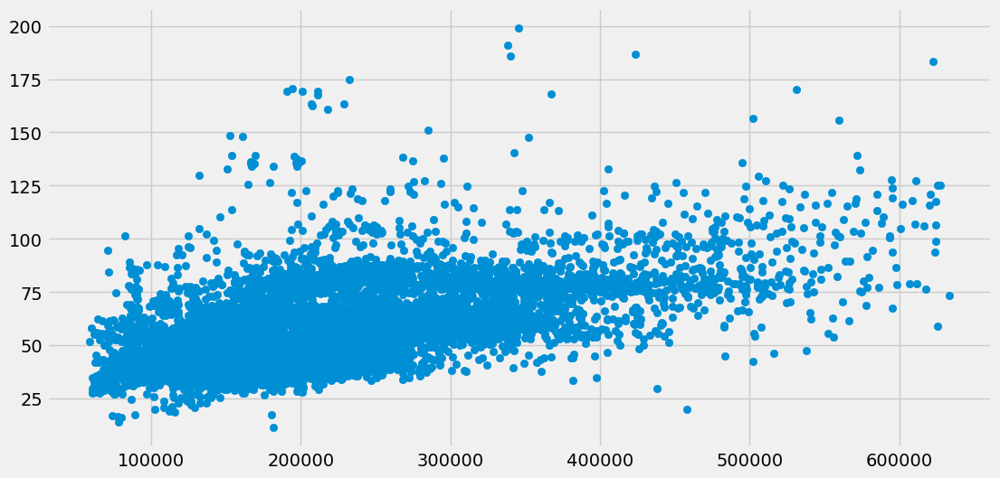

In [41]:
# Проверка данных. Посмотрим на распределение цены квартиры в зависимости от площади.
from pylab import rcParams
rcParams['figure.figsize'] = 12, 6

plt.scatter(y, X.Square)

In [93]:
X_train, X_test, y_train, y_test = train_test_split(X, 
                                                    y, test_size=0.33, random_state=42)
#save test
X_test.to_csv("X_test.csv", index=None)
y_test.to_csv("y_test.csv", index=None)
#save train
X_train.to_csv("X_train.csv", index=None)
y_train.to_csv("y_train.csv", index=None)

### Выбор значимых переменных

Ввиду того, что основная задача данного проекта разворачивание сервера, особого внимания на малозначимые данные уделять не будем.
Возьмем только те, которые имеют максимальную корреляцию с целевой переменной

In [94]:
FEATURES = ['DistrictId', 'Rooms', 'Square', 'LifeSquare', 'KitchenSquare', 'Floor', 'HouseFloor', 'HouseYear']

In [95]:
X_train = X_train[FEATURES]

In [ ]:
#important_data = ['Rooms', 'Square', 'LifeSquare', 'Floor', 'HouseFloor', 'HouseYear',
#       'Social_1', 'Social_2', 'Social_3', 
#       'Helthcare_2', 'Shops_1', 'Price']

### Организуем пайплайн (у нас только числовые признаки)

In [85]:
class ColumnSelector(BaseEstimator, TransformerMixin):
    """
    Transformer to select a single column from the data frame to perform additional transformations on
    """
    def __init__(self, key):
        self.key = key

    def fit(self, X, y=None):
        return self

    def transform(self, X):
        return X[self.key]
    
class NumberSelector(BaseEstimator, TransformerMixin):
    """
    Transformer to select a single column from the data frame to perform additional transformations on
    Use on numeric columns in the data
    """
    def __init__(self, key):
        self.key = key

    def fit(self, X, y=None):
        return self

    def transform(self, X):
        return X[[self.key]]
    

continuos_cols = FEATURES

continuos_transformers = []


for cont_col in continuos_cols:
    transfomer =  Pipeline([
                ('selector', NumberSelector(key=cont_col))
            ])
    continuos_transformers.append((cont_col, transfomer))
    


In [96]:
continuos_transformers

[('DistrictId',
  Pipeline(steps=[('selector', NumberSelector(key='DistrictId'))])),
 ('Rooms', Pipeline(steps=[('selector', NumberSelector(key='Rooms'))])),
 ('Square', Pipeline(steps=[('selector', NumberSelector(key='Square'))])),
 ('LifeSquare',
  Pipeline(steps=[('selector', NumberSelector(key='LifeSquare'))])),
 ('KitchenSquare',
  Pipeline(steps=[('selector', NumberSelector(key='KitchenSquare'))])),
 ('Floor', Pipeline(steps=[('selector', NumberSelector(key='Floor'))])),
 ('HouseFloor',
  Pipeline(steps=[('selector', NumberSelector(key='HouseFloor'))])),
 ('HouseYear',
  Pipeline(steps=[('selector', NumberSelector(key='HouseYear'))]))]

In [97]:
feats = FeatureUnion(continuos_transformers)
feature_processing = Pipeline([('feats', feats)])

feature_processing.fit_transform(X_train)

array([[1.70000000e+01, 3.00000000e+00, 8.09581148e+01, ...,
        1.60000000e+01, 1.60000000e+01, 1.98100000e+03],
       [2.70000000e+01, 3.00000000e+00, 8.36147013e+01, ...,
        1.00000000e+01, 1.00000000e+01, 2.01600000e+03],
       [5.70000000e+01, 1.00000000e+00, 3.60810113e+01, ...,
        4.00000000e+00, 5.00000000e+00, 1.95200000e+03],
       ...,
       [2.70000000e+01, 2.00000000e+00, 6.82719342e+01, ...,
        1.70000000e+01, 1.70000000e+01, 1.97700000e+03],
       [2.70000000e+01, 1.00000000e+00, 4.12908704e+01, ...,
        1.00000000e+00, 1.00000000e+00, 1.97700000e+03],
       [5.30000000e+01, 1.00000000e+00, 3.74168886e+01, ...,
        3.00000000e+00, 2.40000000e+01, 2.01900000e+03]])

### Выбор оптимальной модели

In [88]:
model1 = ensemble.GradientBoostingRegressor(n_estimators=300, max_depth=6, min_samples_split=2,
                                           learning_rate=0.1, loss='ls', random_state=42)
model2 = RandomForestRegressor(n_estimators=300, max_depth=18, random_state=42, max_features=7)
model3 = LGBMRegressor(max_depth=6,
                             n_estimators=300,
                             random_state=42, num_leaves=10)
models = [model1, model2, model3]

In [98]:
for model in models:
    
    regressor = Pipeline([
        ('features',feats),
        ('regressor', model),
    ])


    #запустим кросс-валидацию
    cv_scores = cross_val_score(regressor, X_train, y_train, scoring='r2', 
                           cv=KFold(n_splits=5, shuffle=True, random_state=42))
    cv_score = np.mean(cv_scores)
    cv_score_std = np.std(cv_scores)
    print(model)
    print('CV score is {}+-{}'.format(cv_score, cv_score_std))
    print("***************************************************")

    #обучим пайплайн на всем тренировочном датасете
    #classifier.fit(X_train, y_train)
    #y_score = classifier.predict_proba(X_test)[:, 1]





C:\Users\user\anaconda3\lib\site-packages\sklearn\ensemble\_gb.py:286: FutureWarning: The loss 'ls' was deprecated in v1.0 and will be removed in version 1.2. Use 'squared_error' which is equivalent.
  warnings.warn(
C:\Users\user\anaconda3\lib\site-packages\sklearn\ensemble\_gb.py:286: FutureWarning: The loss 'ls' was deprecated in v1.0 and will be removed in version 1.2. Use 'squared_error' which is equivalent.
  warnings.warn(
C:\Users\user\anaconda3\lib\site-packages\sklearn\ensemble\_gb.py:286: FutureWarning: The loss 'ls' was deprecated in v1.0 and will be removed in version 1.2. Use 'squared_error' which is equivalent.
  warnings.warn(
C:\Users\user\anaconda3\lib\site-packages\sklearn\ensemble\_gb.py:286: FutureWarning: The loss 'ls' was deprecated in v1.0 and will be removed in version 1.2. Use 'squared_error' which is equivalent.
  warnings.warn(
C:\Users\user\anaconda3\lib\site-packages\sklearn\ensemble\_gb.py:286: FutureWarning: The loss 'ls' was deprecated in v1.0 and will 

GradientBoostingRegressor(loss='ls', max_depth=6, n_estimators=300,
                          random_state=42)
CV score is 0.6824221016091141+-0.021799913488503055
***************************************************
RandomForestRegressor(max_depth=18, max_features=7, n_estimators=300,
                      random_state=42)
CV score is 0.6504997955713087+-0.02041952311813443
***************************************************
LGBMRegressor(max_depth=6, n_estimators=300, num_leaves=10, random_state=42)
CV score is 0.6822064366294986+-0.0222573234274839
***************************************************


#### Из данных моделей наибольшую точность показала LGBMRegressor

In [99]:
regressor_best = Pipeline([
        ('features',feats),
        ('regressor', model3),
    ])

In [100]:
# Oбучим пайплайн на всем тренировочном датасете
regressor_best.fit(X_train, y_train)   

Pipeline(steps=[('features',
                 FeatureUnion(transformer_list=[('DistrictId',
                                                 Pipeline(steps=[('selector',
                                                                  NumberSelector(key='DistrictId'))])),
                                                ('Rooms',
                                                 Pipeline(steps=[('selector',
                                                                  NumberSelector(key='Rooms'))])),
                                                ('Square',
                                                 Pipeline(steps=[('selector',
                                                                  NumberSelector(key='Square'))])),
                                                ('LifeSquare',
                                                 Pipeline(steps=[('selector',
                                                                  NumberSelector(key='LifeSquare...
             

### Сохранение модели

In [101]:
with open("model.dill", "wb") as f:
    dill.dump(regressor_best, f)

In [102]:
with open("model.dill", "rb") as in_strm:
    pipeline = dill.load(in_strm)

In [103]:
pipeline

Pipeline(steps=[('features',
                 FeatureUnion(transformer_list=[('DistrictId',
                                                 Pipeline(steps=[('selector',
                                                                  NumberSelector(key='DistrictId'))])),
                                                ('Rooms',
                                                 Pipeline(steps=[('selector',
                                                                  NumberSelector(key='Rooms'))])),
                                                ('Square',
                                                 Pipeline(steps=[('selector',
                                                                  NumberSelector(key='Square'))])),
                                                ('LifeSquare',
                                                 Pipeline(steps=[('selector',
                                                                  NumberSelector(key='LifeSquare...
             

In [106]:
preds = pipeline.predict(X_test)
preds[:10]

array([266921.139842  , 155642.39528243, 149389.3936199 , 206616.23627586,
       379004.51538131, 178899.62644478, 223645.57250663, 224058.07152942,
       356399.19012636, 345129.3524391 ])